In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go

In [2]:
df = pd.read_csv('GSE64881_segmentation_at_30000bp.passqc.multibam.txt', delimiter="\t")

In [3]:
df["start"].describe()

count    9.087700e+04
mean     6.837223e+07
std      4.441972e+07
min      0.000000e+00
25%      3.108000e+07
50%      6.393000e+07
75%      1.007400e+08
max      1.971900e+08
Name: start, dtype: float64

In [4]:
df

,chrom,start,stop,F10A2,F10A3,F10A4,F10A5,F10A6,F10B1,F10B2,...,F9F2,F9F3,F9F4,F9F5,F9F6,F9G1,F9G2,F9G3,F9G4,F9G5
0,chr1,0,30000,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,chr1,30000,60000,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,chr1,60000,90000,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,chr1,90000,120000,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,chr1,120000,150000,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90872,chr4_random,150000,160594,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
90873,chr3_random,0,30000,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
90874,chr3_random,30000,41899,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
90875,chrM,0,16299,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1


In [5]:
nps = df.columns[3:]

In [6]:
radial_pos = pd.DataFrame(df[nps].sum()/(df[nps].sum().max()-df[nps].sum().min()), columns=["Radial_position"])

In [7]:
radial_pos

,Radial_position
F10A2,0.276982
F10A3,0.356584
F10A4,0.233198
F10A5,0.180554
F10A6,0.039401
...,...
F9G1,0.111556
F9G2,0.167782
F9G3,0.161467
F9G4,0.095909


In [8]:
radial_labels = ["strongly_apical","somewhat_apical", 
          "neither_apical_nor_equatorial","somewhat_equatorial",
          "strongly_equatorial"]
radial_pos["Radial_category"] = pd.qcut(radial_pos["Radial_position"], q=5, labels=radial_labels)

In [9]:
radial_pos

,Radial_position,Radial_category
F10A2,0.276982,somewhat_equatorial
F10A3,0.356584,somewhat_equatorial
F10A4,0.233198,neither_apical_nor_equatorial
F10A5,0.180554,somewhat_apical
F10A6,0.039401,strongly_apical
...,...,...
F9G1,0.111556,strongly_apical
F9G2,0.167782,somewhat_apical
F9G3,0.161467,somewhat_apical
F9G4,0.095909,strongly_apical


In [10]:
compac_perc = pd.DataFrame(df[nps].sum(axis=1)/(df[nps].sum(axis=1).max()-df[nps].sum(axis=1).min()), columns=["Compaction_percentage"])

In [11]:
compac_perc

,Compaction_percentage
0,0.000000
1,0.000000
2,0.000000
3,0.000000
4,0.000000
...,...
90872,0.000000
90873,0.000000
90874,0.000000
90875,0.997549


In [12]:
compac_labels = ["1", "2", "3", "4","5","6","7","8","9","10"]
compac_perc["Typical_compaction"] = pd.qcut(compac_perc["Compaction_percentage"], q=10, labels=compac_labels[::-1])

In [13]:
compac_perc

,Compaction_percentage,Typical_compaction
0,0.000000,10
1,0.000000,10
2,0.000000,10
3,0.000000,10
4,0.000000,10
...,...,...
90872,0.000000,10
90873,0.000000,10
90874,0.000000,10
90875,0.997549,1


In [14]:
df_hist1 = df[(df["chrom"]=="chr13") & (df["start"]>=21.7*10**6)
             & (df["stop"]<=24.1*10**6)]

In [15]:
df_hist1.columns

Index(['chrom', 'start', 'stop', 'F10A2', 'F10A3', 'F10A4', 'F10A5', 'F10A6',
       'F10B1', 'F10B2',
       ...
       'F9F2', 'F9F3', 'F9F4', 'F9F5', 'F9F6', 'F9G1', 'F9G2', 'F9G3', 'F9G4',
       'F9G5'],
      dtype='object', length=411)

In [16]:
df_hist1_atleast1np = df_hist1[[col for col in df_hist1.columns[3:] if df_hist1[col].sum() >= 1]]

In [17]:
df_hist1_atleast1np

,F10A3,F10A5,F10B3,F10B5,F10C1,F10C3,F10C4,F10D1,F10D5,F10E3,...,F9A4,F9A5,F9B4,F9B6,F9C5,F9D3,F9D6,F9F2,F9F3,F9G3
69715,1,0,0,0,0,1,0,1,0,0,...,0,0,0,0,0,0,0,1,0,1
69716,1,0,0,1,0,1,0,0,0,0,...,0,0,0,1,0,0,0,1,0,1
69717,0,0,0,1,0,1,0,1,0,0,...,0,0,0,1,1,0,0,1,0,0
69718,1,0,0,1,0,0,0,1,0,0,...,0,0,0,0,1,0,0,1,0,0
69719,0,0,0,1,0,1,0,0,0,0,...,0,0,0,1,0,0,1,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69789,1,0,0,1,0,1,0,1,0,0,...,0,0,0,1,1,1,1,0,0,0
69790,0,0,0,0,0,1,0,1,0,0,...,0,0,0,0,0,1,1,0,0,0
69791,0,0,0,1,0,1,0,1,0,0,...,0,0,0,0,0,1,1,1,0,0
69792,0,0,0,1,0,1,0,1,0,0,...,0,0,0,0,1,1,1,1,0,0


In [18]:
# number of genomic windows = 79
len(df_hist1_atleast1np)

79

In [19]:
# number of NPs = 162
len(df_hist1_atleast1np.columns)

162

In [20]:
# avg number of windows in NP = 15
df_hist1_atleast1np.sum().mean()

14.82716049382716

In [21]:
# smallest number of windows per NP = 1
df_hist1_atleast1np.sum().min()

1

In [22]:
# largest number of windows per NP = 67
df_hist1_atleast1np.sum().max()

67

In [23]:
# avg number of Nps in each window =30 
df_hist1_atleast1np.sum(axis=1).mean()

30.40506329113924

In [24]:
# smallest number of Nps per window = 0
df_hist1_atleast1np.sum(axis=1).min()

0

In [25]:
# largest number of Nps per window = 42
df_hist1_atleast1np.sum(axis=1).max()

42

In [26]:
# Radial position

In [27]:
df_hist1_atleast1np.columns

Index(['F10A3', 'F10A5', 'F10B3', 'F10B5', 'F10C1', 'F10C3', 'F10C4', 'F10D1',
       'F10D5', 'F10E3',
       ...
       'F9A4', 'F9A5', 'F9B4', 'F9B6', 'F9C5', 'F9D3', 'F9D6', 'F9F2', 'F9F3',
       'F9G3'],
      dtype='object', length=162)

In [28]:
radial_pos.loc[list(df_hist1_atleast1np.columns)]["Radial_category"].value_counts()

strongly_equatorial              51
somewhat_equatorial              36
somewhat_apical                  31
neither_apical_nor_equatorial    28
strongly_apical                  16
Name: Radial_category, dtype: int64

In [29]:
df_hist1_atleast1np.index

Int64Index([69715, 69716, 69717, 69718, 69719, 69720, 69721, 69722, 69723,
            69724, 69725, 69726, 69727, 69728, 69729, 69730, 69731, 69732,
            69733, 69734, 69735, 69736, 69737, 69738, 69739, 69740, 69741,
            69742, 69743, 69744, 69745, 69746, 69747, 69748, 69749, 69750,
            69751, 69752, 69753, 69754, 69755, 69756, 69757, 69758, 69759,
            69760, 69761, 69762, 69763, 69764, 69765, 69766, 69767, 69768,
            69769, 69770, 69771, 69772, 69773, 69774, 69775, 69776, 69777,
            69778, 69779, 69780, 69781, 69782, 69783, 69784, 69785, 69786,
            69787, 69788, 69789, 69790, 69791, 69792, 69793],
           dtype='int64')

In [30]:
compac_perc.loc[list(df_hist1_atleast1np.index)]

,Compaction_percentage,Typical_compaction
69715,0.071078,4
69716,0.083333,2
69717,0.095588,1
69718,0.078431,3
69719,0.066176,5
...,...,...
69789,0.090686,1
69790,0.073529,4
69791,0.078431,3
69792,0.075980,3


In [31]:
compac_perc.loc[list(df_hist1_atleast1np.index)]["Typical_compaction"].astype(int).mean()

3.5569620253164556

In [32]:
df_hist1_atleast1np

,F10A3,F10A5,F10B3,F10B5,F10C1,F10C3,F10C4,F10D1,F10D5,F10E3,...,F9A4,F9A5,F9B4,F9B6,F9C5,F9D3,F9D6,F9F2,F9F3,F9G3
69715,1,0,0,0,0,1,0,1,0,0,...,0,0,0,0,0,0,0,1,0,1
69716,1,0,0,1,0,1,0,0,0,0,...,0,0,0,1,0,0,0,1,0,1
69717,0,0,0,1,0,1,0,1,0,0,...,0,0,0,1,1,0,0,1,0,0
69718,1,0,0,1,0,0,0,1,0,0,...,0,0,0,0,1,0,0,1,0,0
69719,0,0,0,1,0,1,0,0,0,0,...,0,0,0,1,0,0,1,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69789,1,0,0,1,0,1,0,1,0,0,...,0,0,0,1,1,1,1,0,0,0
69790,0,0,0,0,0,1,0,1,0,0,...,0,0,0,0,0,1,1,0,0,0
69791,0,0,0,1,0,1,0,1,0,0,...,0,0,0,0,0,1,1,1,0,0
69792,0,0,0,1,0,1,0,1,0,0,...,0,0,0,0,1,1,1,1,0,0


In [33]:
len(df_hist1_atleast1np.columns)

162

In [34]:
jaccard = np.zeros((162,162))

In [35]:
type(jaccard)

numpy.ndarray

In [36]:
jaccard.shape

(162, 162)

In [37]:
l = ["b",1,2,3, "o"]
for i,l1 in enumerate(l):
    for k, j in enumerate(l[i+1:]):
        print(i,l1,k+i+1,j)

0 b 1 1
0 b 2 2
0 b 3 3
0 b 4 o
1 1 2 2
1 1 3 3
1 1 4 o
2 2 3 3
2 2 4 o
3 3 4 o


In [38]:
df_hist1_atleast1np.columns

Index(['F10A3', 'F10A5', 'F10B3', 'F10B5', 'F10C1', 'F10C3', 'F10C4', 'F10D1',
       'F10D5', 'F10E3',
       ...
       'F9A4', 'F9A5', 'F9B4', 'F9B6', 'F9C5', 'F9D3', 'F9D6', 'F9F2', 'F9F3',
       'F9G3'],
      dtype='object', length=162)

In [39]:
df_hist1_atleast1np.columns

Index(['F10A3', 'F10A5', 'F10B3', 'F10B5', 'F10C1', 'F10C3', 'F10C4', 'F10D1',
       'F10D5', 'F10E3',
       ...
       'F9A4', 'F9A5', 'F9B4', 'F9B6', 'F9C5', 'F9D3', 'F9D6', 'F9F2', 'F9F3',
       'F9G3'],
      dtype='object', length=162)

In [40]:
for i,v in enumerate(list(df_hist1_atleast1np.columns)):
    for k,j in enumerate(list(df_hist1_atleast1np.columns)[i+1:]):
        intersection=df_hist1_atleast1np[df_hist1_atleast1np[v]+df_hist1_atleast1np[j] == 2].shape[0]
        union=df_hist1_atleast1np[df_hist1_atleast1np[v]+df_hist1_atleast1np[j] == 1].shape[0]
        jac = round(intersection/(union+1), 2)
        jaccard[i][k+i+1] = jac

jaccard[0]

array([0.  , 0.03, 0.  , 0.8 , 0.03, 0.67, 0.15, 0.47, 0.  , 0.  , 0.82,
       1.  , 0.07, 0.1 , 0.26, 0.91, 0.13, 0.11, 0.24, 0.14, 0.92, 0.69,
       0.09, 0.2 , 0.41, 0.05, 0.03, 0.03, 0.04, 0.12, 0.03, 1.03, 0.05,
       0.07, 0.12, 0.03, 1.1 , 0.14, 0.03, 0.08, 0.37, 0.03, 0.19, 0.07,
       0.25, 0.68, 0.41, 0.28, 0.05, 0.05, 0.17, 0.29, 0.03, 0.  , 0.18,
       0.03, 0.05, 0.07, 0.12, 0.  , 0.14, 0.85, 0.1 , 0.42, 0.07, 0.21,
       0.02, 0.05, 0.03, 0.  , 0.12, 0.29, 0.16, 0.16, 0.1 , 0.42, 0.1 ,
       0.29, 0.05, 0.02, 0.03, 0.12, 0.34, 0.39, 0.33, 0.18, 0.17, 0.05,
       0.05, 0.11, 0.07, 0.07, 0.86, 0.07, 0.1 , 0.44, 0.53, 0.07, 0.12,
       0.05, 0.05, 0.05, 0.  , 0.1 , 0.1 , 0.1 , 0.76, 0.03, 0.02, 0.05,
       0.25, 0.02, 0.29, 0.21, 0.17, 0.08, 0.  , 0.05, 0.02, 0.97, 0.8 ,
       0.  , 0.19, 0.05, 0.15, 0.03, 0.02, 0.07, 0.02, 0.05, 0.24, 0.  ,
       0.02, 0.  , 0.  , 0.92, 0.  , 0.  , 0.08, 0.14, 0.08, 0.08, 0.  ,
       0.6 , 0.4 , 0.42, 0.  , 0.17, 0.05, 0.02, 0.

In [41]:
jaccard[1]

array([0.  , 0.  , 0.  , 0.02, 0.  , 0.02, 0.  , 0.  , 0.  , 0.  , 0.02,
       0.02, 0.  , 0.  , 0.  , 0.02, 0.  , 0.  , 0.  , 0.  , 0.02, 0.03,
       0.  , 0.  , 0.03, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.02, 0.  ,
       0.  , 0.  , 0.  , 0.02, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
       0.  , 0.03, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
       0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.02, 0.  , 0.03, 0.  , 0.  ,
       0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.06, 0.  , 0.14, 0.  , 0.  ,
       0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
       0.  , 0.  , 0.  , 0.  , 0.02, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
       0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.02, 0.  , 0.  , 0.  ,
       0.05, 0.  , 0.04, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
       0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.04, 0.  ,
       0.  , 0.  , 0.  , 0.01, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
       0.02, 0.03, 0.03, 0.  , 0.14, 0.  , 0.  , 0.

In [42]:
jaccard[2]

array([0.  , 0.  , 0.  , 0.02, 0.  , 0.02, 0.  , 0.  , 0.  , 0.  , 0.02,
       0.02, 0.  , 0.  , 0.03, 0.02, 0.  , 0.  , 0.  , 0.  , 0.02, 0.  ,
       0.1 , 0.  , 0.03, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.02, 0.  ,
       0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
       0.05, 0.03, 0.  , 0.  , 0.  , 0.  , 0.  , 0.03, 0.  , 0.  , 0.05,
       0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.02, 0.  , 0.  , 0.  , 0.  ,
       0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
       0.  , 0.  , 0.  , 0.  , 0.1 , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
       0.  , 0.  , 0.  , 0.  , 0.02, 0.14, 0.  , 0.02, 0.03, 0.  , 0.11,
       0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.02, 0.  , 0.  , 0.  ,
       0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.02,
       0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
       0.  , 0.  , 0.  , 0.01, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
       0.02, 0.03, 0.03, 0.  , 0.  , 0.17, 0.  , 0.

In [43]:
jaccard[10][0:10]

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

In [44]:
jaccard[160]

array([0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
       0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
       0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
       0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
       0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
       0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
       0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
       0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
       0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
       0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
       0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
       0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
       0. , 0. , 0. , 0. , 0. , 0.2])

In [45]:
matrix_2 = np.triu(jaccard, k=1).T
jaccard_2 = jaccard + matrix_2
jaccard_2_distance = 1 - jaccard_2
#lower_triangular_matrix = np.triu(upper_triangular_matrix, k=1).T

# Combine them
#new_matrix = upper_triangular_matrix + lower_triangular_matrix

In [46]:
jaccard_distance = 1-jaccard

In [47]:
jaccard_distance

array([[1.  , 0.97, 1.  , ..., 0.56, 0.64, 0.62],
       [1.  , 1.  , 1.  , ..., 1.  , 0.96, 1.  ],
       [1.  , 1.  , 1.  , ..., 1.  , 1.  , 1.  ],
       ...,
       [1.  , 1.  , 1.  , ..., 1.  , 0.77, 0.88],
       [1.  , 1.  , 1.  , ..., 1.  , 1.  , 0.8 ],
       [1.  , 1.  , 1.  , ..., 1.  , 1.  , 1.  ]])

In [48]:
data_1 = pd.DataFrame(data=jaccard_distance, index=df_hist1_atleast1np.columns, 
                   columns= df_hist1_atleast1np.columns)
data_2 = pd.DataFrame(data=jaccard, index=df_hist1_atleast1np.columns, 
                   columns= df_hist1_atleast1np.columns)

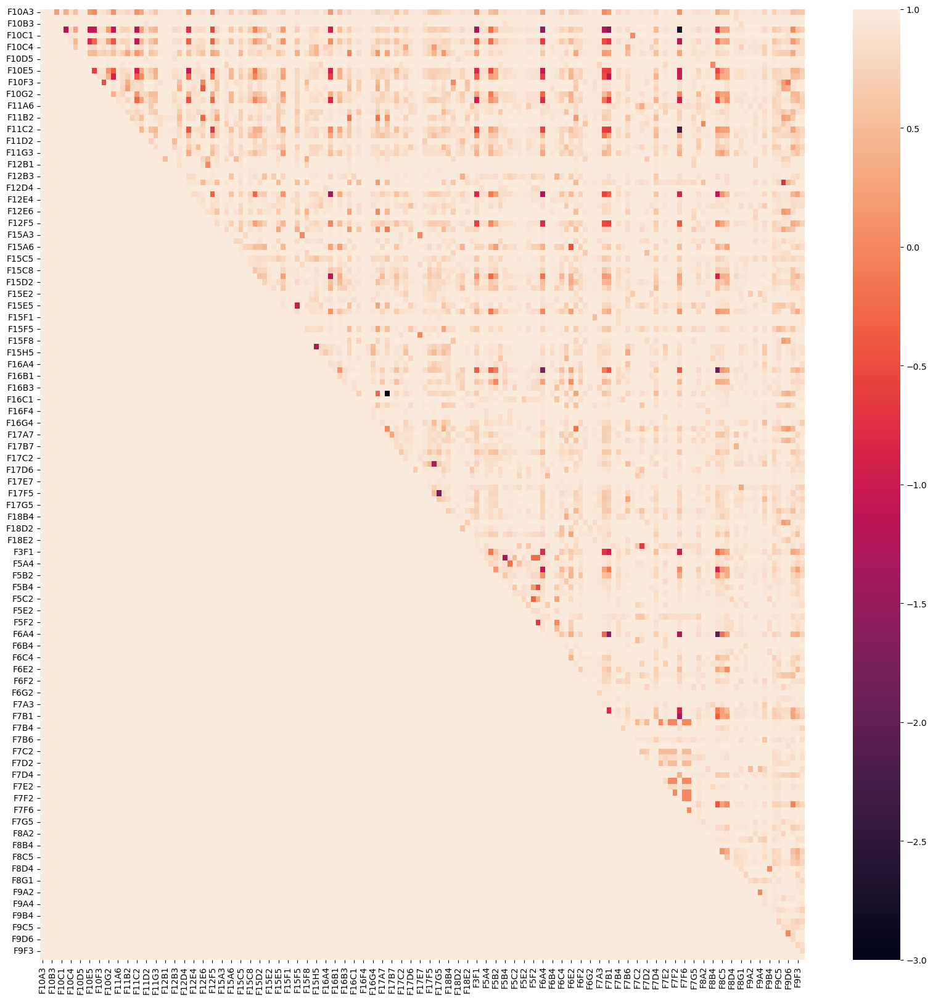

In [49]:
plt.figure(figsize=(20,20))
sns.heatmap(data_1)
plt.savefig("heatmap1.png")
plt.show()

In [50]:
data_3 = pd.DataFrame(data=jaccard_2, index=df_hist1_atleast1np.columns, 
                   columns= df_hist1_atleast1np.columns)
data_4 = pd.DataFrame(data=jaccard_2_distance, index=df_hist1_atleast1np.columns, 
                   columns= df_hist1_atleast1np.columns)

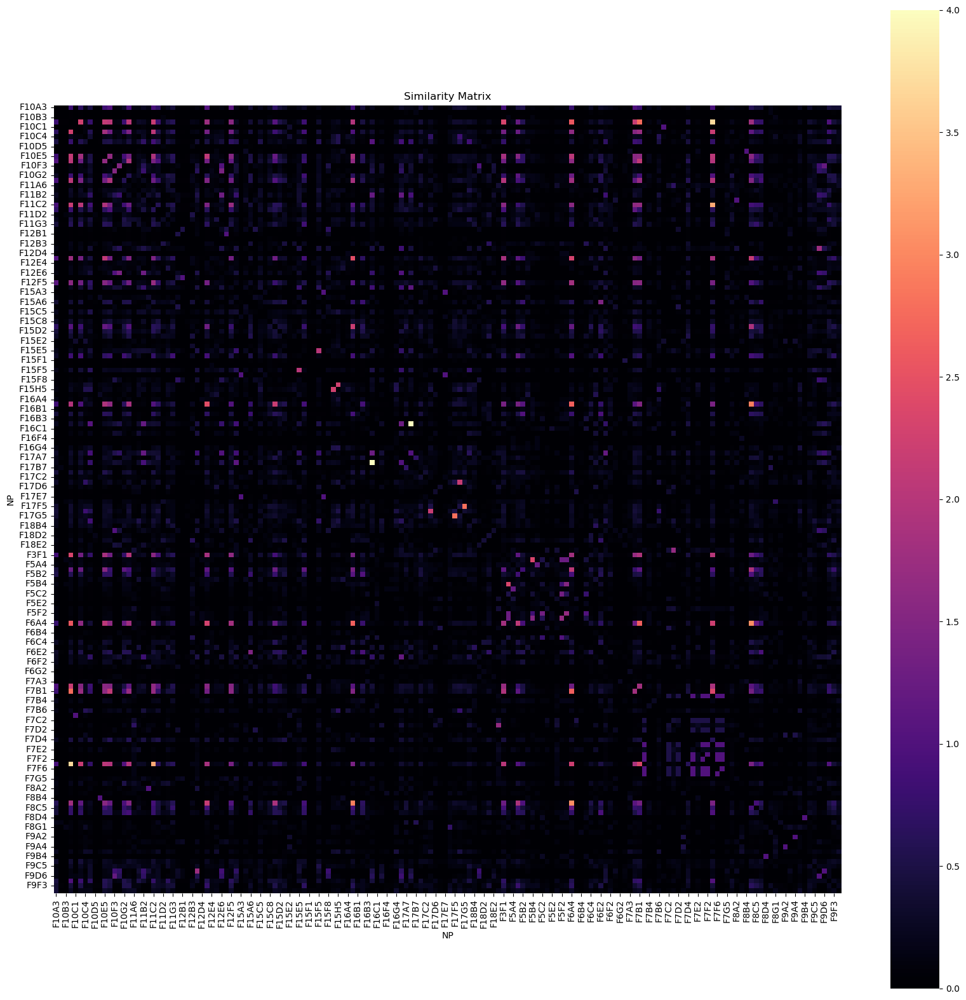

In [51]:
plt.figure(figsize=(20,20))
sns.heatmap(data_3, cmap="magma", square=True)
plt.title("Similarity Matrix")
plt.xlabel("NP")
plt.ylabel("NP")
plt.savefig("heatmap3.png")
plt.show()

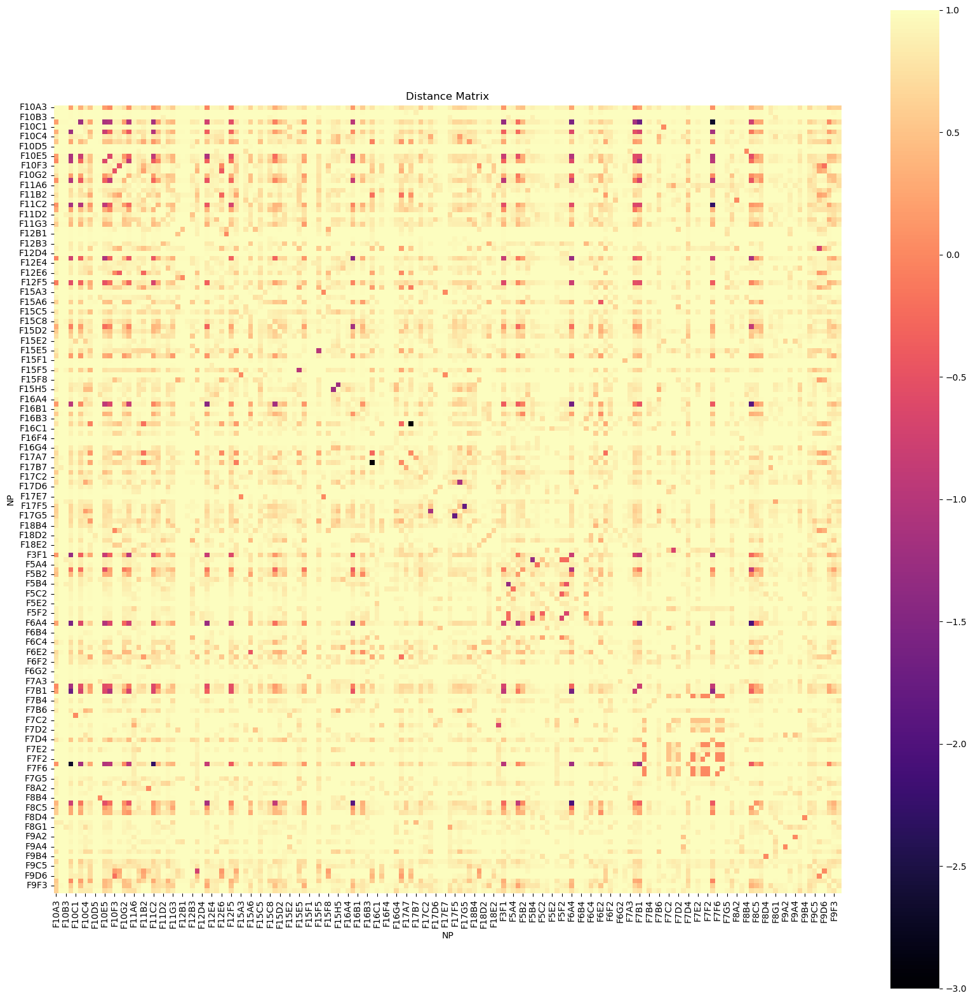

In [52]:
plt.figure(figsize=(20,20))
sns.heatmap(data_4, cmap="magma", square=True)
plt.title("Distance Matrix")
plt.xlabel("NP")
plt.ylabel("NP")
plt.savefig("heatmap4.png")
plt.show()

In [53]:
jaccard_non_skewed = np.zeros((162,162))
for i,v in enumerate(list(df_hist1_atleast1np.columns)):
    for k,j in enumerate(list(df_hist1_atleast1np.columns)[i+1:]):
        intersection=df_hist1_atleast1np[(df_hist1_atleast1np[v]==1) & (df_hist1_atleast1np[j]==1)].shape[0]
        set1=df_hist1_atleast1np[(df_hist1_atleast1np[v]==1)].shape[0]
        set2=df_hist1_atleast1np[(df_hist1_atleast1np[j]==1)].shape[0]
        new_union=min(set1,set2)
        jac = round(intersection/(new_union+1), 2)
        jaccard_non_skewed[i][k+i+1] = jac

In [54]:
jaccard_non_skewed

array([[0.  , 0.5 , 0.  , ..., 0.49, 0.52, 0.75],
       [0.  , 0.  , 0.  , ..., 0.  , 0.5 , 0.  ],
       [0.  , 0.  , 0.  , ..., 0.  , 0.  , 0.  ],
       ...,
       [0.  , 0.  , 0.  , ..., 0.  , 0.37, 0.31],
       [0.  , 0.  , 0.  , ..., 0.  , 0.  , 0.38],
       [0.  , 0.  , 0.  , ..., 0.  , 0.  , 0.  ]])

In [55]:
matrix_6 = np.triu(jaccard_non_skewed, k=1).T
jaccard_not_skewed= jaccard_non_skewed + matrix_6

In [56]:
jaccard_not_skewed_distance = 1 - jaccard_not_skewed

In [57]:
jaccard_not_skewed_distance

array([[1.  , 0.5 , 1.  , ..., 0.51, 0.48, 0.25],
       [0.5 , 1.  , 1.  , ..., 1.  , 0.5 , 1.  ],
       [1.  , 1.  , 1.  , ..., 1.  , 1.  , 1.  ],
       ...,
       [0.51, 1.  , 1.  , ..., 1.  , 0.63, 0.69],
       [0.48, 0.5 , 1.  , ..., 0.63, 1.  , 0.62],
       [0.25, 1.  , 1.  , ..., 0.69, 0.62, 1.  ]])

In [58]:
new_data = pd.DataFrame(jaccard_not_skewed_distance, columns=df_hist1_atleast1np.columns, index=df_hist1_atleast1np.columns)     

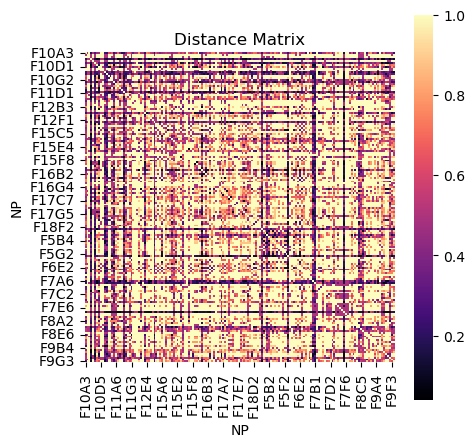

In [59]:
plt.figure(figsize=(5,5))
sns.heatmap(new_data, cmap="magma", square=True)
plt.title("Distance Matrix")
plt.xlabel("NP")
plt.ylabel("NP")
plt.savefig("heatmap5.png")
plt.show()

In [60]:

def kmeans_distance_matrix(df, num_clusters, max_iter=100):
    num_features = df.shape[0]
    centroids_idx = None

    # Function to assign clusters
    def assign_clusters(df, centroids_idx):
        # An array full of zeros to store the cluster values for each feature (NP)
        clusters = np.zeros(num_features, dtype=int)
        # This loop iterates over all NPs and compare the distance between each of them to the three selected NPs. Then it is going
        # to assign the index as the cluster name
        for i, feature in enumerate(df.index):
            # A dataframe to include randomly selected NPs in columns and the feature in row
            distances_to_centroids = df.loc[feature, centroids_idx]
            # Find the index of the selected NP that has min distance to the feature in row 
            closest_centroid = np.argmin(distances_to_centroids)
            # Assign the index of the selected NP to the feature in row , which acts as a cluster number (0, 1 or 2)
            clusters[i] = closest_centroid
        return clusters # this is an array full of cluster numbers, i.e. it includes 0,1 or 2 for each of NPs.

    # Select initial centroids and ensure each cluster has at least 5 members
    initial_attempt = 1
    while True:
        centroids_idx = np.random.choice(df.index, num_clusters, replace=False)
        clusters = assign_clusters(df, centroids_idx)

        # Check cluster sizes
        all_clusters_valid = True
        for k in range(num_clusters):
            if np.sum(clusters == k) < 5:
                all_clusters_valid = False
                initial_attempt +=1
                break
        
        if all_clusters_valid:
            #print(f"Number of initial attempt is {initial_attempt}")
            break
            
    #print(f"Initial Centroids: {centroids_idx}")
    counter = 0
    for iteration in range(max_iter):
        clusters = assign_clusters(df, centroids_idx)

        # Ensure centroids are part of their clusters
        for idx, centroid in enumerate(centroids_idx):
            centroid_index = df.index.get_loc(centroid)
            clusters[centroid_index] = idx

        # Print features in each cluster
        cluster_members = {k: [] for k in range(num_clusters)}
        for i, cluster_id in enumerate(clusters):
            cluster_members[cluster_id].append(df.index[i])
        #print(f"Iteration {iteration}")
        #for k, members in cluster_members.items():
            #print(f"  Cluster {k}: {members}")

        new_centroids_idx = []
        list_variation = []
        for k in range(num_clusters):
            cluster_indices = df.index[clusters == k]

            #if len(cluster_indices) == 0:
                #new_centroids_idx.append(np.random.choice(df.index))
                #continue

            intra_cluster_distances = df.loc[cluster_indices, cluster_indices]
            avg_distances = intra_cluster_distances.mean(axis=1)
            new_centroid = avg_distances.idxmin()
            new_centroids_idx.append(new_centroid)

            # Calculate variation within the cluster
            cluster_variation = np.sum((intra_cluster_distances[new_centroid])**2)
            list_variation.append(cluster_variation)

        total_variation = sum(list_variation)
        #print(f"Total variation: {total_variation}")
        if set(centroids_idx) == set(new_centroids_idx):
            counter += 1
            if counter == 3:
                #print("Convergence reached.")
                break

        centroids_idx = new_centroids_idx
        #print("")
        #print(f"New Centroids: {centroids_idx}")

    return clusters, cluster_members, centroids_idx, total_variation


In [61]:
# Apply the function on my data


best_variation = 1000
for num_loops in range(100):
    num_clusters = 3
    clusters, cluster_members, centroids_idx, total_variation  = kmeans_distance_matrix(new_data, num_clusters)
    if total_variation < best_variation:
        best_variation = total_variation
        best_clusters = clusters
        best_medoids = centroids_idx
        best_cluster_members = cluster_members


print("Final cluster labels:", best_clusters)
print("Best Medoids:", best_medoids)
print("Best Variation", round(best_variation, 3))
print("Dictionary of clusters", best_cluster_members)

Final cluster labels: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 2
 0 0 0 2 0 0 2 0 2 0 2 0 0 0 0 0 0 0 0 0 0 0 0 0 2 0 2 0 0 0 1 2 0 2 0 2 0
 2 2 2 2 1 0 0 2 0 2 0 0 1 0 0 0 0 1 0 2 2 2 2 0 2 2 0 2 0 0 0 0 2 0 0 0 2
 1 2 0 2 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 2 0 2 2 0 0 2
 0 1 0 0 0 0 0 1 0 0 0 0 2 0]
Best Medoids: ['F7F3', 'F11C2', 'F6A4']
Best Variation 14.247
Dictionary of clusters {0: ['F10A3', 'F10A5', 'F10B3', 'F10B5', 'F10C1', 'F10C3', 'F10C4', 'F10D1', 'F10D5', 'F10E3', 'F10E5', 'F10F1', 'F10F3', 'F10F5', 'F11A3', 'F11A6', 'F11B1', 'F11B2', 'F11B5', 'F11D1', 'F11D2', 'F11D4', 'F11G3', 'F11G4', 'F12B1', 'F12B2', 'F12B3', 'F12C6', 'F12D4', 'F12E1', 'F12E4', 'F12E5', 'F12E6', 'F12F1', 'F12G1', 'F15A3', 'F15A5', 'F15B5', 'F15C5', 'F15C8', 'F15D2', 'F15E2', 'F15E4', 'F15E5', 'F15E7', 'F15F1', 'F15F3', 'F15F5', 'F15F6', 'F15F8', 'F15H1', 'F15H5', 'F16A2', 'F16A4', 'F16B1', 'F16B3', 'F16B6', 'F16C1', 'F16G3', 'F16G6', 'F17B1', 'F17E6', 

In [62]:
first_cluster = df_hist1_atleast1np[best_cluster_members[0]]
second_cluster = df_hist1_atleast1np[best_cluster_members[1]]
third_cluster = df_hist1_atleast1np[best_cluster_members[2]]

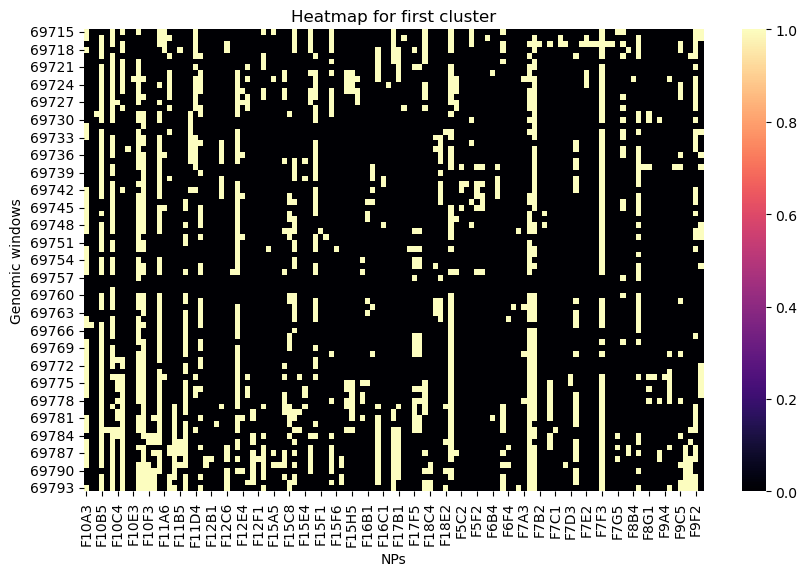

In [63]:
#df_hist1_atleast1np[best_cluster_members[0]]
plt.figure(figsize=(10,6))
sns.heatmap(first_cluster, cmap="magma")
plt.title("Heatmap for first cluster")
plt.xlabel("NPs")
plt.ylabel("Genomic windows")
plt.show()

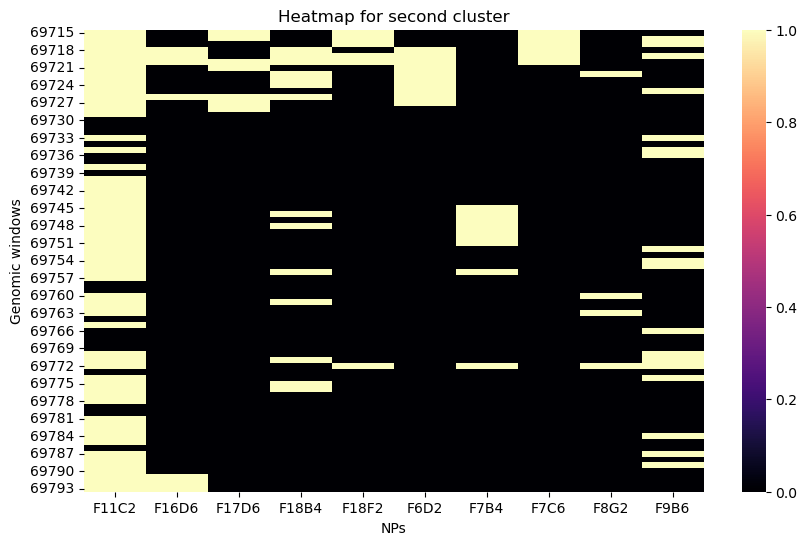

In [64]:
plt.figure(figsize=(10,6))
sns.heatmap(second_cluster, cmap="magma")
plt.title("Heatmap for second cluster")
plt.xlabel("NPs")
plt.ylabel("Genomic windows")
plt.show()

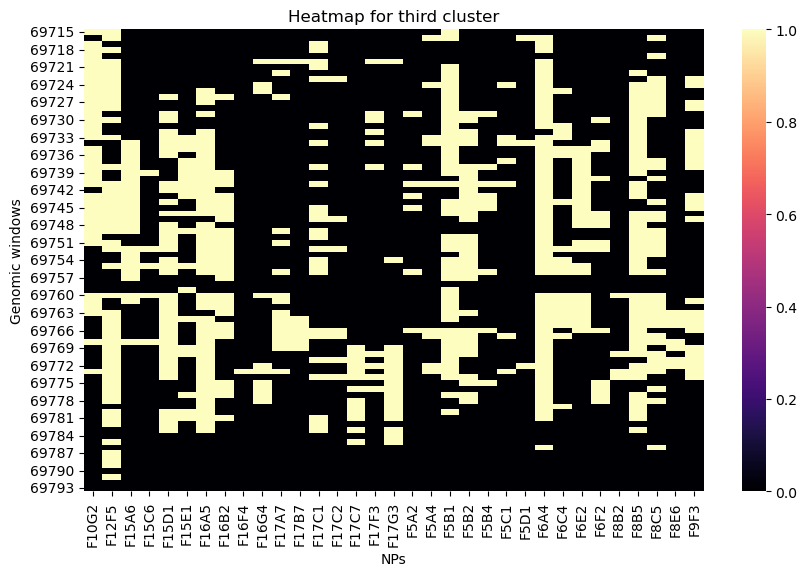

In [65]:
plt.figure(figsize=(10,6))
sns.heatmap(third_cluster, cmap="magma")
plt.title("Heatmap for third cluster")
plt.xlabel("NPs")
plt.ylabel("Genomic windows")
plt.show()

In [66]:
feature_df = pd.read_csv("xid-280141502_1.csv")

In [67]:
feature_df.columns

Index(['name', 'CHD2', 'EP300', 'ZNF384', 'CTCF-7BWU', 'ZC3H11A', 'NANOG',
       'HCFC1', 'MAFK', 'LAD', 'RNAPII-S5P', 'RNAPII-S7P', 'h3k27me3', 'Hist1',
       'Vmn', 'H3K9me3', 'pou5f1', 'sox2', 'H3K36me3', 'med12', 'RNAPII-S2P',
       'tcf3', 'Enhancer', 'H3K20me3'],
      dtype='object')

In [68]:
feature_df = feature_df[["LAD", "Hist1"]]

In [69]:
feature_df = feature_df.iloc[1:len(feature_df)-1]

In [70]:
feature_df

,LAD,Hist1
1,0,0
2,0,0
3,0,1
4,0,1
5,0,1
...,...,...
75,0,0
76,0,0
77,0,1
78,0,0


In [71]:
feature_df.index = df_hist1_atleast1np.index

In [72]:
feature_df

,LAD,Hist1
69715,0,0
69716,0,0
69717,0,1
69718,0,1
69719,0,1
...,...,...
69789,0,0
69790,0,0
69791,0,1
69792,0,0


In [73]:
df_hist1_atleast1np

,F10A3,F10A5,F10B3,F10B5,F10C1,F10C3,F10C4,F10D1,F10D5,F10E3,...,F9A4,F9A5,F9B4,F9B6,F9C5,F9D3,F9D6,F9F2,F9F3,F9G3
69715,1,0,0,0,0,1,0,1,0,0,...,0,0,0,0,0,0,0,1,0,1
69716,1,0,0,1,0,1,0,0,0,0,...,0,0,0,1,0,0,0,1,0,1
69717,0,0,0,1,0,1,0,1,0,0,...,0,0,0,1,1,0,0,1,0,0
69718,1,0,0,1,0,0,0,1,0,0,...,0,0,0,0,1,0,0,1,0,0
69719,0,0,0,1,0,1,0,0,0,0,...,0,0,0,1,0,0,1,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69789,1,0,0,1,0,1,0,1,0,0,...,0,0,0,1,1,1,1,0,0,0
69790,0,0,0,0,0,1,0,1,0,0,...,0,0,0,0,0,1,1,0,0,0
69791,0,0,0,1,0,1,0,1,0,0,...,0,0,0,0,0,1,1,1,0,0
69792,0,0,0,1,0,1,0,1,0,0,...,0,0,0,0,1,1,1,1,0,0


In [74]:
first_cluster

,F10A3,F10A5,F10B3,F10B5,F10C1,F10C3,F10C4,F10D1,F10D5,F10E3,...,F9A2,F9A3,F9A4,F9A5,F9B4,F9C5,F9D3,F9D6,F9F2,F9G3
69715,1,0,0,0,0,1,0,1,0,0,...,0,0,0,0,0,0,0,0,1,1
69716,1,0,0,1,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,1,1
69717,0,0,0,1,0,1,0,1,0,0,...,0,0,0,0,0,1,0,0,1,0
69718,1,0,0,1,0,0,0,1,0,0,...,0,0,0,0,0,1,0,0,1,0
69719,0,0,0,1,0,1,0,0,0,0,...,0,0,0,0,0,0,0,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69789,1,0,0,1,0,1,0,1,0,0,...,0,0,0,0,0,1,1,1,0,0
69790,0,0,0,0,0,1,0,1,0,0,...,0,0,0,0,0,0,1,1,0,0
69791,0,0,0,1,0,1,0,1,0,0,...,0,0,0,0,0,0,1,1,1,0
69792,0,0,0,1,0,1,0,1,0,0,...,0,0,0,0,0,1,1,1,1,0


In [75]:
#count = (df['column1'] == 1) & (df['column2'] == 1)
#similar_rows_count = count.sum()

In [76]:
def custom_func(cluster1, cluster2, cluster3, feature_table, plot):
    
    array_1 = np.zeros(cluster1.shape[1])
    array_2 = np.zeros(cluster1.shape[1])
    for i, v in enumerate(list(cluster1.columns)):
        count_hist1_1 = (cluster1[v]==1) & (feature_table["Hist1"]==1)
        count_lad_1 = (cluster1[v]==1) & (feature_table["LAD"]==1)
        array_1[i] = (count_hist1_1.sum()/0.79)        
        array_2[i] = (count_lad_1.sum()/0.79)
    
    array_3 = np.zeros(cluster2.shape[1])
    array_4 = np.zeros(cluster2.shape[1])
    for i, v in enumerate(list(cluster2.columns)):
        count_hist1_2 = (cluster2[v]==1) & (feature_table["Hist1"]==1)
        count_lad_2 = (cluster2[v]==1) & (feature_table["LAD"]==1)
        array_3[i] = (count_hist1_2.sum()/0.79)        
        array_4[i] = (count_lad_2.sum()/0.79)


    array_5 = np.zeros(cluster3.shape[1])
    array_6 = np.zeros(cluster3.shape[1])
    for i, v in enumerate(list(cluster3.columns)):
        count_hist1_3 = (cluster3[v]==1) & (feature_table["Hist1"]==1)
        count_lad_3 = (cluster3[v]==1) & (feature_table["LAD"]==1)
        array_5[i] = (count_hist1_3.sum()/0.79)        
        array_6[i] = (count_lad_3.sum()/0.79)

    if plot=="boxplot":
        
        plt.figure(figsize=(10,10))
        plt.subplot(2,1,1)
        plt.boxplot([array_1, array_3, array_5])
        plt.title("hist1_box")
        plt.xlabel("Clusters")
        plt.ylabel("Percentage of windows")
        plt.grid()

    #plt.subplot(4,1,2)
    #plt.bar([array_1, array_3, array_5])
    #plt.title("hist1_bar")
    #plt.xlabel("NPs")
    #plt.ylabel("Percentage of windows")
    #plt.grid()

    #plt.subplot(4,1,3)
        plt.subplot(2,1,2)
        plt.boxplot([array_2, array_4, array_6])
        plt.title("LAD_box")
        plt.xlabel("Clusters")
        plt.ylabel("Percentage of windows")
        plt.grid()    

    #plt.subplot(4,1,4)
    #plt.barplot([array_2, array_4, array_6])
    #plt.title("LAD_bar")
    #plt.xlabel("NPs")
    #plt.ylabel("Percentage of windows")
    #plt.grid()
        plt.tight_layout()
        plt.show()

    elif plot=="barplot":
        plt.figure(figsize=(13,20))
                            
        plt.subplot(6,1,1)
        plt.bar(x=cluster1.columns, height= array_1)
        plt.title("hist1_bar for cluster 1")
        plt.xlabel("NPs")
        plt.ylabel("Percentage of windows")
        plt.xticks(rotation=90)
        plt.grid()

        plt.subplot(6,1,2)
        plt.bar(x=cluster1.columns, height= array_2)
        plt.title("LAD_bar for cluster 1")
        plt.xlabel("NPs")
        plt.ylabel("Percentage of windows")
        plt.xticks(rotation=90)
        plt.grid()
        
        plt.subplot(6,1,3)
        plt.bar(x=cluster2.columns, height= array_3)
        plt.title("hist1_bar for cluster 2")
        plt.xlabel("NPs")
        plt.ylabel("Percentage of windows")
        plt.xticks(rotation=90)
        plt.grid()
        
        plt.subplot(6,1,4)
        plt.bar(x=cluster2.columns, height= array_4)
        plt.title("LAD_bar for cluster 2")
        plt.xlabel("NPs")
        plt.ylabel("Percentage of windows")
        plt.xticks(rotation=90)
        plt.grid()
        
        plt.subplot(6,1,5)
        plt.bar(x=cluster3.columns, height= array_5)
        plt.title("hist1_bar for cluster 3")
        plt.xlabel("NPs")
        plt.ylabel("Percentage of windows")
        plt.xticks(rotation=90)
        plt.grid()
        
        plt.subplot(6,1,6)
        plt.bar(x=cluster3.columns, height= array_6)
        plt.title("LAD_bar for cluster 3")
        plt.xlabel("NPs")
        plt.ylabel("Percentage of windows")
        plt.xticks(rotation=90)
        plt.grid() 
        
        plt.tight_layout()
        plt.show()
# cluster = cluster_first, cluster_second, ...
# feature_table = feature_df
# plot = barplot, boxplot

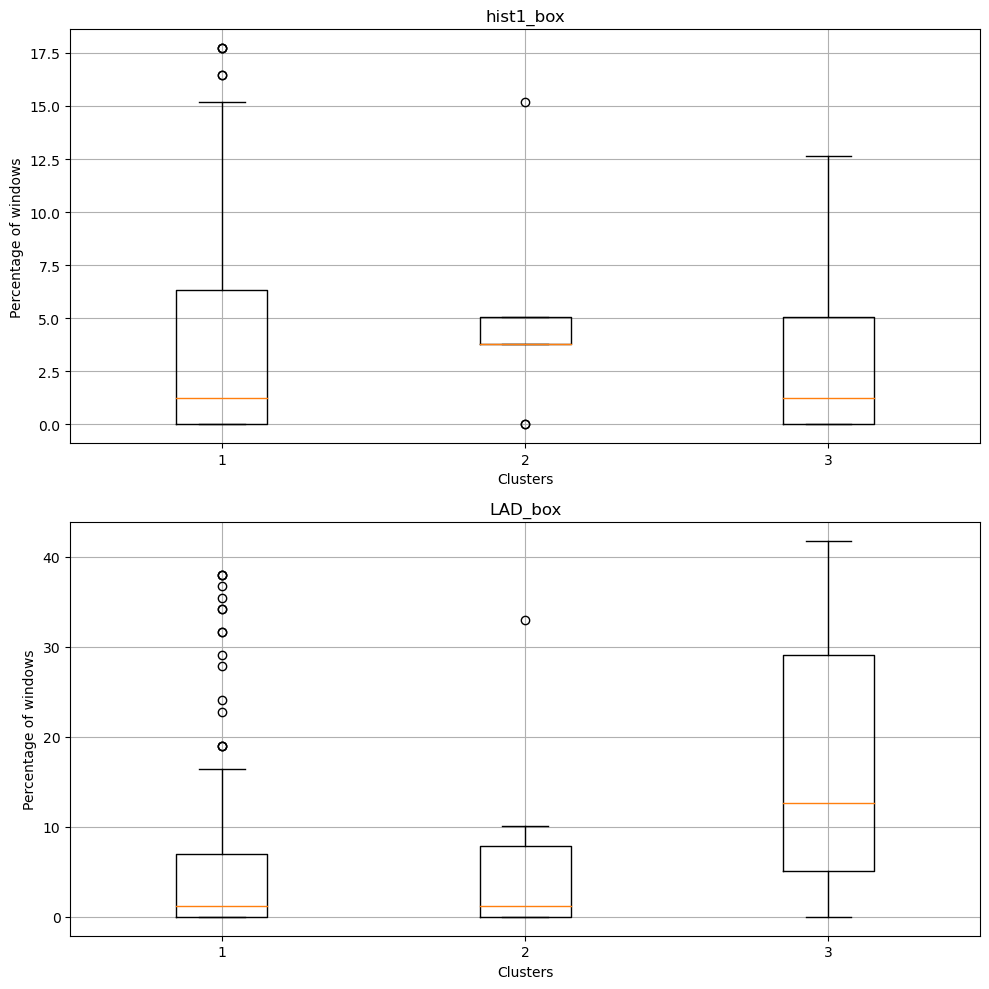

In [77]:
custom_func(first_cluster, second_cluster, third_cluster, feature_df, plot="boxplot")

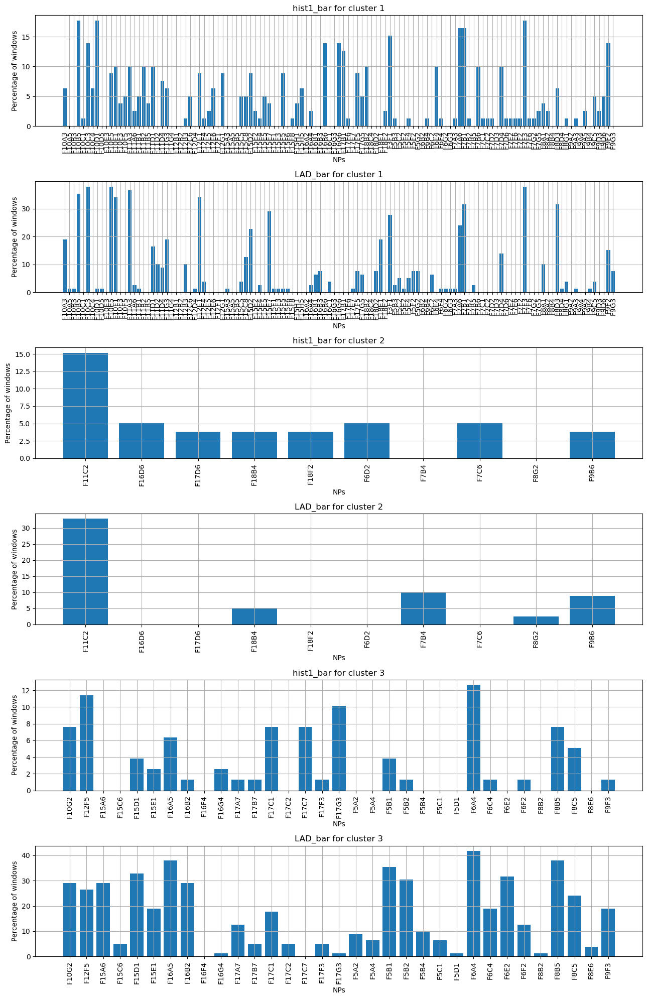

In [78]:
custom_func(first_cluster, second_cluster, third_cluster, feature_df, plot="barplot")

In [79]:
radial_pos

,Radial_position,Radial_category
F10A2,0.276982,somewhat_equatorial
F10A3,0.356584,somewhat_equatorial
F10A4,0.233198,neither_apical_nor_equatorial
F10A5,0.180554,somewhat_apical
F10A6,0.039401,strongly_apical
...,...,...
F9G1,0.111556,strongly_apical
F9G2,0.167782,somewhat_apical
F9G3,0.161467,somewhat_apical
F9G4,0.095909,strongly_apical


In [80]:
clust_1 = radial_pos.loc[first_cluster.transpose().index]

In [81]:
list(clust_1["Radial_category"].value_counts().index)

['strongly_equatorial',
 'somewhat_equatorial',
 'somewhat_apical',
 'neither_apical_nor_equatorial',
 'strongly_apical']

In [82]:
clust_1["Radial_category"].value_counts()/(len(clust_1.index)*0.01)

strongly_equatorial              34.453782
somewhat_equatorial              20.168067
somewhat_apical                  19.327731
neither_apical_nor_equatorial    14.285714
strongly_apical                  11.764706
Name: Radial_category, dtype: float64

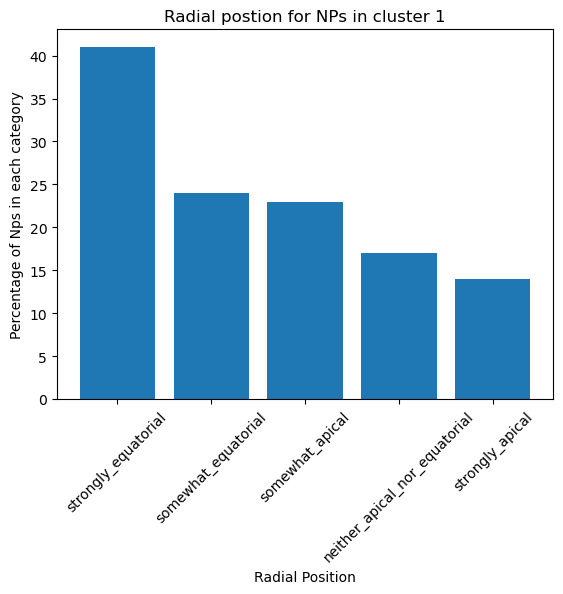

In [83]:
plt.bar(x=list(clust_1["Radial_category"].value_counts().index), height=list(clust_1["Radial_category"].value_counts().values))
plt.xticks(rotation=45)
plt.xlabel("Radial Position")
plt.ylabel("Percentage of Nps in each category")
plt.title("Radial postion for NPs in cluster 1")
plt.show()

In [84]:
clust_2 = radial_pos.loc[second_cluster.transpose().index]

In [85]:
clust_2["Radial_category"].value_counts()/(len(clust_2.index)*0.01)

neither_apical_nor_equatorial    40.0
strongly_equatorial              30.0
somewhat_equatorial              20.0
strongly_apical                  10.0
somewhat_apical                   0.0
Name: Radial_category, dtype: float64

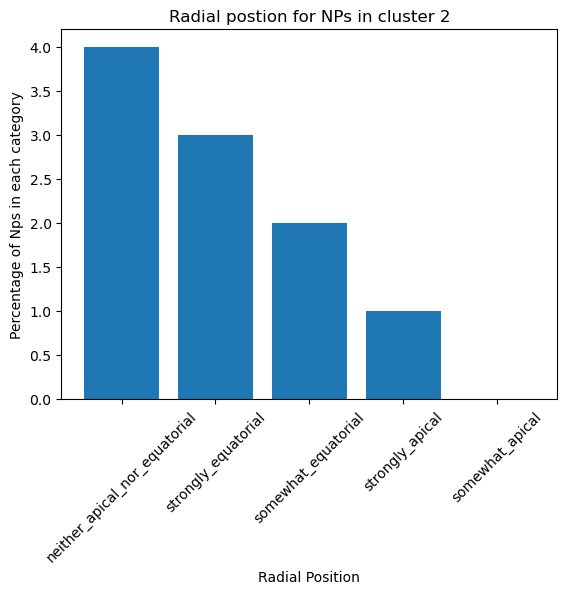

In [86]:
plt.bar(x=list(clust_2["Radial_category"].value_counts().index), height=list(clust_2["Radial_category"].value_counts().values))
plt.xticks(rotation=45)
plt.xlabel("Radial Position")
plt.ylabel("Percentage of Nps in each category")
plt.title("Radial postion for NPs in cluster 2")
plt.show()

In [87]:
clust_3 = radial_pos.loc[third_cluster.transpose().index]

In [88]:
clust_3["Radial_category"].value_counts()/(len(clust_3.index)*0.01)

somewhat_equatorial              30.303030
somewhat_apical                  24.242424
neither_apical_nor_equatorial    21.212121
strongly_equatorial              21.212121
strongly_apical                   3.030303
Name: Radial_category, dtype: float64

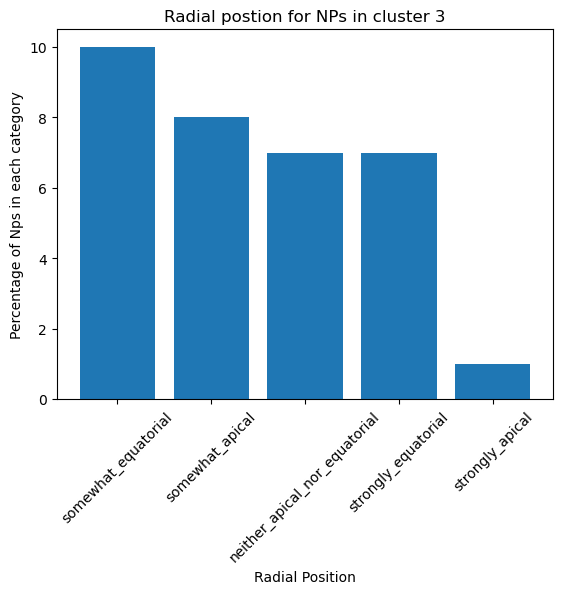

In [89]:
plt.bar(x=list(clust_3["Radial_category"].value_counts().index), height=list(clust_3["Radial_category"].value_counts().values))
plt.xticks(rotation=45)
plt.xlabel("Radial Position")
plt.ylabel("Percentage of Nps in each category")
plt.title("Radial postion for NPs in cluster 3")
plt.show()

In [90]:
feature_dff = pd.read_csv("xid-280141502_1.csv")
feature_dff = feature_dff[["Hist1", "Vmn", "LAD", 'RNAPII-S5P', 'RNAPII-S7P', 'RNAPII-S2P','Enhancer', 'H3K20me3', 'H3K36me3','h3k27me3', 'H3K9me3','NANOG','pou5f1','sox2', 'CTCF-7BWU']]
feature_dff = feature_dff.iloc[1:len(feature_dff)-1]
feature_dff.index = df_hist1_atleast1np.index

In [91]:
feature_dff

,Hist1,Vmn,LAD,RNAPII-S5P,RNAPII-S7P,RNAPII-S2P,Enhancer,H3K20me3,H3K36me3,h3k27me3,H3K9me3,NANOG,pou5f1,sox2,CTCF-7BWU
69715,0,0,0,0,0,0,0,1,1,0,1,0,0,0,0
69716,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
69717,1,0,0,1,1,1,0,0,0,0,0,0,0,0,2
69718,1,0,0,1,1,1,0,1,0,0,0,0,1,1,2
69719,1,0,0,1,1,1,1,0,0,0,0,0,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69789,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
69790,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1
69791,1,0,0,1,1,1,0,0,0,1,1,0,0,0,0
69792,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [92]:
def custom_func2(cluster, feature_table, plot, chart_name):
    
    arr = np.zeros((15, cluster.shape[1]))
    ftcol = list(feature_table.columns)
    for i, v in enumerate(list(cluster.columns)):
        
        mydict = {}
        
        mydict["Hist1"] = (cluster[v]==1) & (feature_table["Hist1"]>=1)
        mydict["VMN"] = (cluster[v]==1) & (feature_table["Vmn"]>=1)
        mydict["LAD"]= (cluster[v]==1) & (feature_table["LAD"]>=1)
        mydict['RNAPII-S5P'] = (cluster[v]==1) & (feature_table[ftcol[3]]>=1)
        mydict['RNAPII-S7P'] = (cluster[v]==1) & (feature_table[ftcol[4]]>=1)
        mydict['RNAPII-S2P'] = (cluster[v]==1) & (feature_table[ftcol[5]]>=1)
        mydict["Enhancer"] = (cluster[v]==1) & (feature_table[ftcol[6]]>=1)
        mydict['H3K20me3'] = (cluster[v]==1) & (feature_table[ftcol[7]]>=1)
        mydict['H3K36me3']= (cluster[v]==1) & (feature_table[ftcol[8]]>=1)
        mydict['H3K27me3'] = (cluster[v]==1) & (feature_table[ftcol[9]]>=1)
        mydict['H3K9me3'] = (cluster[v]==1) & (feature_table[ftcol[10]]>=1)
        mydict["NANOG"] = (cluster[v]==1) & (feature_table[ftcol[11]]>=1)
        mydict['pou5f1'] = (cluster[v]==1) & (feature_table[ftcol[12]]>=1)
        mydict["sox2"] = (cluster[v]==1) & (feature_table[ftcol[13]]>=1)
        mydict['CTCF-7BWU'] = (cluster[v]==1) & (feature_table[ftcol[14]]>=1)

        for j,k in enumerate(mydict.keys()):
            arr[j][i] = (mydict[k].sum()/0.79)
    
            
    avgper = (np.sum(arr, axis=1)/cluster.shape[1])
    avgpercat = avgper.tolist()

    if plot=="radar":
        categories = list(mydict.keys())

        values = avgpercat

        fig = go.Figure()

        fig.add_trace(go.Scatterpolar(
              r=values,
              theta=categories,
              fill='toself'
        ))

        
        fig.update_layout(
            polar=dict(
            radialaxis=dict(
              visible=True
            )),
            showlegend=False,
            title=dict(
                text=chart_name,
                font=dict(
                    size=20,
                    family='Arial',
            ),
                #xanchor='center',
                x=0.5,
                yanchor='top'
            ) 
            
            
        )

        fig.show()

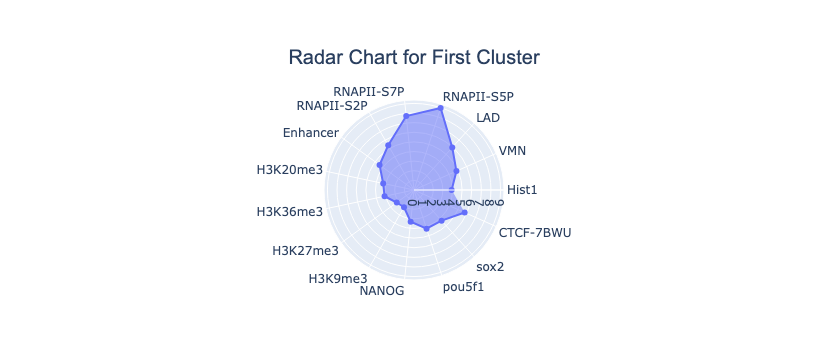

In [93]:
custom_func2(first_cluster, feature_dff, "radar", "Radar Chart for First Cluster")

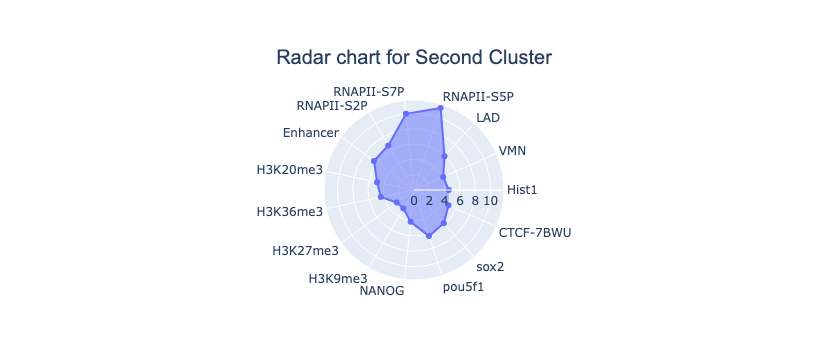

In [94]:
custom_func2(second_cluster, feature_dff, "radar", "Radar chart for Second Cluster")

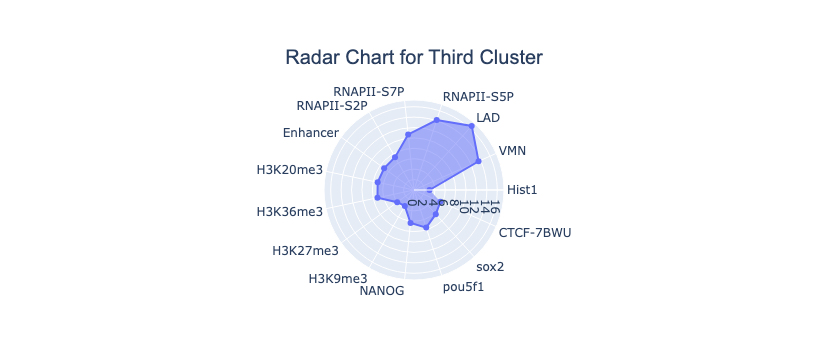

In [95]:
custom_func2(third_cluster, feature_dff, "radar", "Radar Chart for Third Cluster")

In [96]:
df_hist1_atleast1np

,F10A3,F10A5,F10B3,F10B5,F10C1,F10C3,F10C4,F10D1,F10D5,F10E3,...,F9A4,F9A5,F9B4,F9B6,F9C5,F9D3,F9D6,F9F2,F9F3,F9G3
69715,1,0,0,0,0,1,0,1,0,0,...,0,0,0,0,0,0,0,1,0,1
69716,1,0,0,1,0,1,0,0,0,0,...,0,0,0,1,0,0,0,1,0,1
69717,0,0,0,1,0,1,0,1,0,0,...,0,0,0,1,1,0,0,1,0,0
69718,1,0,0,1,0,0,0,1,0,0,...,0,0,0,0,1,0,0,1,0,0
69719,0,0,0,1,0,1,0,0,0,0,...,0,0,0,1,0,0,1,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69789,1,0,0,1,0,1,0,1,0,0,...,0,0,0,1,1,1,1,0,0,0
69790,0,0,0,0,0,1,0,1,0,0,...,0,0,0,0,0,1,1,0,0,0
69791,0,0,0,1,0,1,0,1,0,0,...,0,0,0,0,0,1,1,1,0,0
69792,0,0,0,1,0,1,0,1,0,0,...,0,0,0,0,1,1,1,1,0,0


In [97]:
(df_hist1_atleast1np.sum(axis=1)/162).iloc[[0,1,2,3]] # detection frequency of each, fa, fb

69715    0.179012
69716    0.209877
69717    0.240741
69718    0.197531
dtype: float64

In [98]:
#arr = np.zeros((79,79))
#for i in range(79):
    #for j in range(i+1,79):
        #arr[i][j] = ((df.iloc[[i,j],].sum()==2).sum()/162) - (((df_hist1_atleast1np.sum(axis=1)/162).iloc[i])*((df_hist1_atleast1np.sum(axis=1)/162).iloc[i]))
        
        
import itertools
import seaborn

In [99]:
def func(d):
    if d<0:
        return min(f_a*f_b, (1-f_a)*(1-f_b))
    elif d>0:
        return min(f_a*(1-f_b), f_b*(1-f_a))
    else:
        return 1

empty_list = []
for row1,row2 in itertools.combinations(df_hist1_atleast1np.iterrows(), 2):
    f_a = row1[1].sum()/162
    f_b = row2[1].sum()/162
    f_ab = np.sum((row1[1]==1) & (row2[1]==1))/162
    
    d = f_ab - (f_a*f_b)
    
    d_max = func(d)

    normalized_linkage = d/d_max

    empty_list.append(normalized_linkage)


In [100]:
length = len(empty_list)

In [101]:
# n(n+1)/2 = 3081
import math
n = int((-1+math.sqrt(1+8*length))/2)
n

78

In [102]:
# make list to uppertriangular matrix
matrix = np.zeros((n,n))
upper_indx = np.triu_indices(n)
matrix[upper_indx]= empty_list
matrix

array([[0.65086207, 0.59125315, 0.48435013, ..., 0.26949602, 0.23242959,
        0.2265252 ],
       [0.        , 0.57388809, 0.44628906, ..., 0.16943359, 0.18346774,
        0.16943359],
       [0.        , 0.        , 0.58841463, ..., 0.2179878 , 0.3202203 ,
        0.25914634],
       ...,
       [0.        , 0.        , 0.        , ..., 0.62615385, 0.58778626,
        0.58461538],
       [0.        , 0.        , 0.        , ..., 0.        , 0.75880893,
        0.64951923],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.71861042]])

In [103]:
rows,cols = np.triu_indices(n,k=1)
matrix[cols,rows] = matrix[rows,cols]

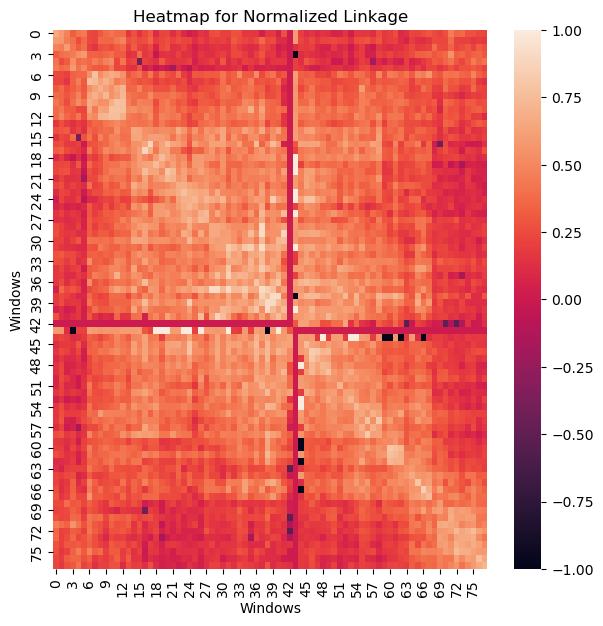

In [104]:
plt.figure(figsize=(7,7))
sns.heatmap(matrix)
plt.title("Heatmap for Normalized Linkage")
plt.xlabel("Windows")
plt.ylabel("Windows")
plt.show()

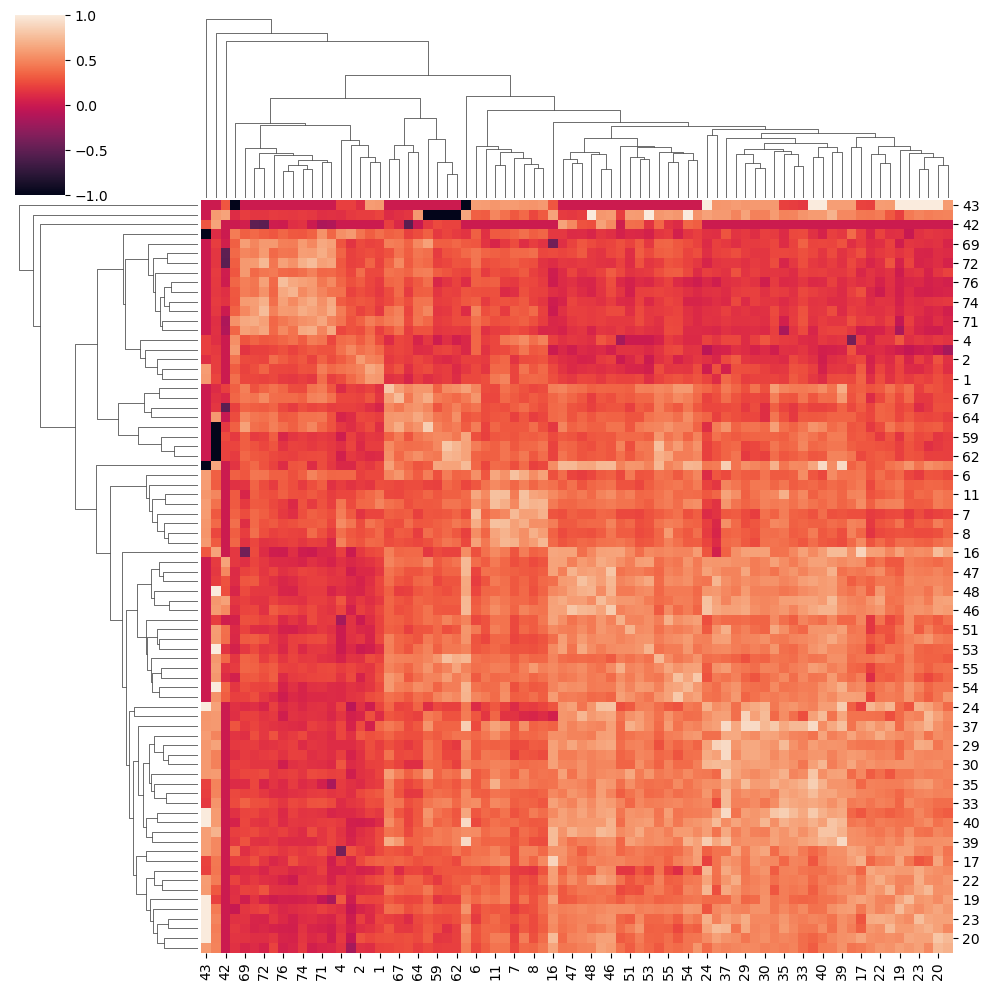

In [105]:
sns.clustermap(matrix)
plt.show()

In [106]:
matrix

array([[0.65086207, 0.59125315, 0.48435013, ..., 0.26949602, 0.23242959,
        0.2265252 ],
       [0.59125315, 0.57388809, 0.44628906, ..., 0.16943359, 0.18346774,
        0.16943359],
       [0.48435013, 0.44628906, 0.58841463, ..., 0.2179878 , 0.3202203 ,
        0.25914634],
       ...,
       [0.26949602, 0.16943359, 0.2179878 , ..., 0.62615385, 0.58778626,
        0.58461538],
       [0.23242959, 0.18346774, 0.3202203 , ..., 0.58778626, 0.75880893,
        0.64951923],
       [0.2265252 , 0.16943359, 0.25914634, ..., 0.58461538, 0.64951923,
        0.71861042]])

In [107]:
sum(empty_list)/len(empty_list)

0.3471111402500587

In [108]:
len(empty_list)

3081

In [109]:
import math
78*79/2

3081.0

In [110]:
n=79
matrix_2 = np.zeros((n,n))
upper_indx = np.triu_indices(n,k=1)
matrix_2[upper_indx]= empty_list
matrix_2

array([[0.        , 0.65086207, 0.59125315, ..., 0.26949602, 0.23242959,
        0.2265252 ],
       [0.        , 0.        , 0.57388809, ..., 0.16943359, 0.18346774,
        0.16943359],
       [0.        , 0.        , 0.        , ..., 0.2179878 , 0.3202203 ,
        0.25914634],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.75880893,
        0.64951923],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.71861042],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]])

In [111]:
matrix_3 = (matrix_2 > (sum(empty_list)/len(empty_list)))

In [112]:
matrix_3.shape

(79, 79)

In [113]:
true_indices = np.where(matrix_3)
true_coordinates = list(zip(true_indices[0], true_indices[1]))
print(true_coordinates)

[(0, 1), (0, 2), (0, 3), (0, 5), (0, 6), (0, 10), (0, 11), (0, 12), (0, 13), (0, 44), (0, 72), (0, 74), (1, 2), (1, 3), (1, 4), (1, 6), (1, 9), (1, 10), (1, 11), (1, 12), (1, 13), (1, 38), (1, 44), (1, 72), (2, 3), (2, 4), (2, 6), (2, 13), (2, 69), (3, 4), (3, 5), (3, 6), (3, 10), (3, 11), (3, 16), (3, 68), (3, 71), (3, 72), (3, 74), (3, 77), (4, 5), (4, 6), (4, 7), (4, 8), (4, 9), (4, 10), (4, 11), (4, 13), (4, 71), (4, 72), (4, 76), (4, 77), (4, 78), (5, 6), (5, 7), (5, 11), (6, 7), (6, 8), (6, 9), (6, 10), (6, 11), (6, 12), (6, 13), (6, 15), (6, 16), (6, 18), (6, 20), (6, 23), (6, 31), (6, 34), (6, 37), (6, 39), (6, 40), (6, 44), (6, 52), (6, 53), (6, 55), (6, 56), (6, 59), (6, 61), (6, 62), (6, 64), (6, 66), (6, 67), (6, 68), (6, 71), (6, 72), (6, 73), (6, 74), (6, 76), (7, 8), (7, 9), (7, 10), (7, 11), (7, 12), (7, 13), (7, 14), (7, 31), (7, 36), (7, 41), (7, 44), (7, 46), (7, 56), (7, 57), (7, 71), (8, 9), (8, 10), (8, 11), (8, 12), (8, 13), (8, 14), (8, 15), (8, 16), (8, 18), (8

In [114]:
len(true_coordinates)

1522

In [116]:
import matplotlib.pyplot as plt
import networkx as nx

# List of edges
#edges = [(1, 2), (2, 3), (3, 4), (4, 1)]

# Create a graph
G = nx.Graph()
G.add_edges_from(true_coordinates)

# Draw the graph
plt.figure(figsize=(100, 100))
nx.draw(G, with_labels=True, node_color='lightblue', node_size=400, font_size=20, font_weight='bold')
plt.title("Graph Visualization")
plt.savefig("network.png", format="png")
plt.show()

In [117]:
# Calculate degree centrality
centrality = nx.degree_centrality(G)

# Creating a DataFrame
data = {'Degree': dict(G.degree()), 'Degree of Centrality': centrality}
df = pd.DataFrame(data)

# Display the DataFrame
df.sort_values(by="Degree of Centrality", ascending=False)

,Degree,Degree of Centrality
55,59,0.766234
36,58,0.753247
31,57,0.740260
38,56,0.727273
34,55,0.714286
...,...,...
0,12,0.155844
78,12,0.155844
75,12,0.155844
2,7,0.090909


In [118]:
df["Degree"].describe()

count    78.000000
mean     39.025641
std      15.263039
min       6.000000
25%      27.000000
50%      46.000000
75%      51.000000
max      59.000000
Name: Degree, dtype: float64

In [119]:
# Window #43 has no edges and it's not in the ranking
df_hist1_atleast1np.iloc[43]

F10A3    0
F10A5    0
F10B3    0
F10B5    0
F10C1    0
        ..
F9D3     0
F9D6     0
F9F2     0
F9F3     0
F9G3     0
Name: 69758, Length: 162, dtype: int64

In [152]:
def compute_degree_centrality(edges):
    #Create a dictionary to hold degree count for each node
    degree_count = {}
    for edge in edges:
        for node in edge:
            if node in degree_count:
                degree_count[node] += 1
            else:
                degree_count[node] = 1

    # Calculate the maximum possible degree
    max_possible_degree = len(degree_count)

    # Compute centrality by dividing degree by max_possible_degree
    centrality = {node: degree / max_possible_degree for node, degree in degree_count.items()}

    return centrality
    

In [153]:
centrality = compute_degree_centrality(true_coordinates)

In [155]:
for node, centrality_value in centrality.items():
    print(f"Node {node}: {centrality_value:.2f}")

Node 0: 0.15
Node 1: 0.17
Node 2: 0.09
Node 3: 0.18
Node 5: 0.08
Node 6: 0.51
Node 10: 0.54
Node 11: 0.68
Node 12: 0.65
Node 13: 0.53
Node 44: 0.56
Node 72: 0.24
Node 74: 0.18
Node 4: 0.21
Node 9: 0.46
Node 38: 0.72
Node 69: 0.19
Node 16: 0.68
Node 68: 0.53
Node 71: 0.27
Node 77: 0.19
Node 7: 0.23
Node 8: 0.35
Node 76: 0.22
Node 78: 0.15
Node 15: 0.64
Node 18: 0.69
Node 20: 0.62
Node 23: 0.60
Node 31: 0.73
Node 34: 0.71
Node 37: 0.68
Node 39: 0.67
Node 40: 0.68
Node 52: 0.65
Node 53: 0.64
Node 55: 0.76
Node 56: 0.69
Node 59: 0.65
Node 61: 0.41
Node 62: 0.68
Node 64: 0.28
Node 66: 0.59
Node 67: 0.56
Node 73: 0.19
Node 14: 0.69
Node 36: 0.74
Node 41: 0.64
Node 46: 0.65
Node 57: 0.60
Node 22: 0.59
Node 32: 0.60
Node 35: 0.64
Node 47: 0.68
Node 17: 0.58
Node 19: 0.51
Node 21: 0.60
Node 50: 0.67
Node 58: 0.58
Node 60: 0.36
Node 63: 0.35
Node 45: 0.62
Node 49: 0.64
Node 24: 0.54
Node 27: 0.51
Node 28: 0.63
Node 29: 0.59
Node 33: 0.65
Node 42: 0.45
Node 48: 0.59
Node 51: 0.59
Node 54: 0.64
No

In [123]:
def compute_community(edges):
    # Create a dictionary to hold degree count for each node
    degree_count = {}
    
    for edge in edges:
        # For each node in the edge, increment its count
        for node in edge:
            if node in degree_count:
                degree_count[node] += 1
            else:
                degree_count[node] = 1

    # Calculate the maximum possible degree
    max_possible_degree = len(degree_count)

    # Compute centrality by dividing degree by max_possible_degree
    centrality = {node: degree / max_possible_degree for node, degree in degree_count.items()}

    return centrality

In [124]:
edges = true_coordinates

In [146]:
community_2 = []
hub = 36
for i, v in edges:
    if hub in [i, v]: 
        if (i, v) in edges:
            community_2.append((i, v))
        elif (v, i) in edges:  
            community_2.append((v, i))

In [147]:
len(community_2)

58

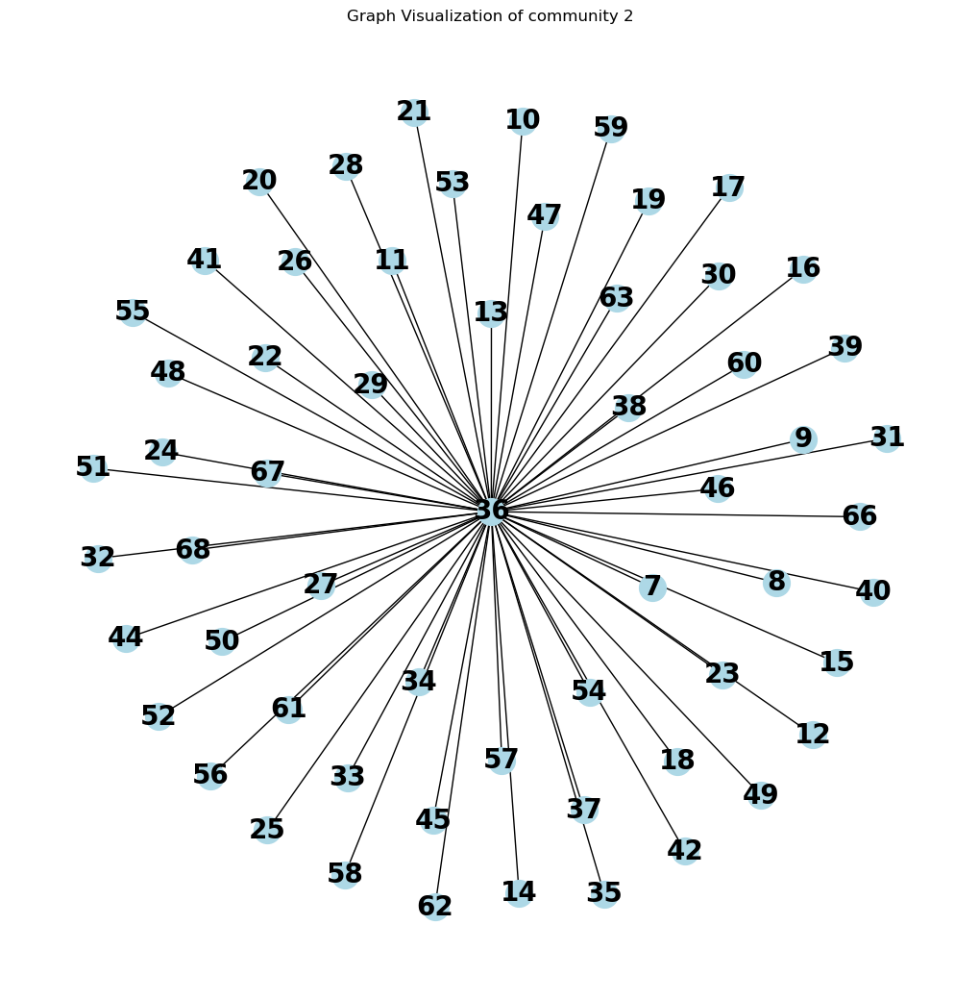

In [148]:
import matplotlib.pyplot as plt
import networkx as nx

G = nx.Graph()
G.add_edges_from(community_2)

# Draw the graph
plt.figure(figsize=(10, 10))
nx.draw(G, with_labels=True, node_color='lightblue', node_size=400, font_size=20, font_weight='bold')
plt.title("Graph Visualization of community 2")
#plt.savefig("network.png", format="png")
plt.show()